In [24]:
#!/usr/bin/env python

# --------------------------------------------------------
# Faster R-CNN
# Copyright (c) 2015 Microsoft
# Licensed under The MIT License [see LICENSE for details]
# Written by Ross Girshick
# --------------------------------------------------------

"""
Demo script showing detections in sample images.

See README.md for installation instructions before running.
"""

import _init_paths
from fast_rcnn.config import cfg
from fast_rcnn.test import im_detect
from fast_rcnn.nms_wrapper import nms
from utils.timer import Timer
import matplotlib.pyplot as plt
import numpy as np
import scipy.io as sio
import caffe, os, sys, cv2
import argparse
import json
%matplotlib inline



In [34]:

CLASSES = ('__background__',
           'pedestrian')

NETS = {'vgg16': ('VGG16',
                  'VGG16_faster_rcnn_final.caffemodel'),
        'zf': ('ZF',
                  'ZF_faster_rcnn_final.caffemodel')}


def vis_detections(im, class_name, dets, thresh=0.5):
    """Draw detected bounding boxes."""
    inds = np.where(dets[:, -1] >= thresh)[0]
    if len(inds) == 0:
        return

    im = im[:, :, (2, 1, 0)]
    fig, ax = plt.subplots(figsize=(12, 12))
    ax.imshow(im, aspect='equal')
    for i in inds:
        bbox = dets[i, :4]
        score = dets[i, -1]

        ax.add_patch(
            plt.Rectangle((bbox[0], bbox[1]),
                          bbox[2] - bbox[0],
                          bbox[3] - bbox[1], fill=False,
                          edgecolor='red', linewidth=3.5)
            )
        ax.text(bbox[0], bbox[1] - 2,
                '{:s} {:.3f}'.format(class_name, score),
                bbox=dict(facecolor='blue', alpha=0.5),
                fontsize=14, color='white')

    ax.set_title(('{} detections with '
                  'p({} | box) >= {:.1f}').format(class_name, class_name,
                                                  thresh),
                  fontsize=14)
    plt.axis('off')
    plt.tight_layout()
    plt.draw()


def compare_detection(im, class_name, dets,gt_boxes , thresh=0.5):
    """Render the Predicited detection and ground truth detection together."""
    inds = np.where(dets[:, -1] >= thresh)[0]
    if len(inds) == 0:
        return

    im = im[:, :, (2, 1, 0)]
    fig, ax = plt.subplots(figsize=(12, 12))
    ax.imshow(im, aspect='equal')
    
    
    if gt_boxes:
        for gt_box in gt_boxes:
            gt_box = gt_box['pos']
            x1 = gt_box[0]
            y1 = gt_box[1]
            width = gt_box[2]
            length = gt_box[3]
            gt_rectangle = plt.Rectangle((x1,y1), width,length, fill=False, edgecolor='blue', linewidth=3.5)
            ax.add_patch(gt_rectangle)
    
    
    for i in inds:
        bbox = dets[i, :4]
        score = dets[i, -1]

        ax.add_patch(
            plt.Rectangle((bbox[0], bbox[1]),
                          bbox[2] - bbox[0],
                          bbox[3] - bbox[1], fill=False,
                          edgecolor='red', linewidth=3.5)
            )
        ax.text(bbox[0], bbox[1] - 2,
                '{:s} {:.3f}'.format(class_name, score),
                bbox=dict(facecolor='blue', alpha=0.5),
                fontsize=14, color='white')
        
        
        
    ax.set_title(('{} detections with '
                  'p({} | box) >= {:.1f}').format(class_name, class_name,
                                                  thresh),
                  fontsize=14)
    plt.axis('off')
    plt.tight_layout()
    plt.draw()

def show_detection(net, image_name, gt_boxes):
    """Detect object classes in an image using pre-computed object proposals."""

    # Load the demo image
    im_file = os.path.join("/root/data/caltech-pedestrian-dataset-converter/data/images", image_name)
    im = cv2.imread(im_file)

    # Detect all object classes and regress object bounds
    timer = Timer()
    timer.tic()
    scores, boxes = im_detect(net, im)
    timer.toc()
    print ('Detection took {:.3f}s for '
           '{:d} object proposals').format(timer.total_time, boxes.shape[0])

    # Visualize detections for each class
    CONF_THRESH = 0.9
    NMS_THRESH = 0.3
    for cls_ind, cls in enumerate(CLASSES[1:]):
        cls_ind += 1 # because we skipped background
        cls_boxes = boxes[:, 4*cls_ind:4*(cls_ind + 1)]
        cls_scores = scores[:, cls_ind]
        dets = np.hstack((cls_boxes,
                          cls_scores[:, np.newaxis])).astype(np.float32)
        keep = nms(dets, NMS_THRESH)
        dets = dets[keep, :]
        #vis_detections(im, cls, dets, thresh=CONF_THRESH)
        compare_detection(im, cls, dets,gt_boxes,  thresh=CONF_THRESH)
    
    
def demo(net, image_name):
    """Detect object classes in an image using pre-computed object proposals."""

    # Load the demo image
    im_file = os.path.join("/root/data/caltech-pedestrian-dataset-converter/data/images", image_name)
    im = cv2.imread(im_file)

    # Detect all object classes and regress object bounds
    timer = Timer()
    timer.tic()
    scores, boxes = im_detect(net, im)
    timer.toc()
    print ('Detection took {:.3f}s for '
           '{:d} object proposals').format(timer.total_time, boxes.shape[0])

    # Visualize detections for each class
    CONF_THRESH = 0.9
    NMS_THRESH = 0.3
    for cls_ind, cls in enumerate(CLASSES[1:]):
        cls_ind += 1 # because we skipped background
        cls_boxes = boxes[:, 4*cls_ind:4*(cls_ind + 1)]
        cls_scores = scores[:, cls_ind]
        dets = np.hstack((cls_boxes,
                          cls_scores[:, np.newaxis])).astype(np.float32)
        keep = nms(dets, NMS_THRESH)
        dets = dets[keep, :]
        vis_detections(im, cls, dets, thresh=CONF_THRESH)

def parse_args():
    """Parse input arguments."""
    parser = argparse.ArgumentParser(description='Faster R-CNN demo')
    parser.add_argument('--gpu', dest='gpu_id', help='GPU device id to use [0]',
                        default=0, type=int)
    parser.add_argument('--cpu', dest='cpu_mode',
                        help='Use CPU mode (overrides --gpu)',
                        action='store_true')
    parser.add_argument('--net', dest='demo_net', help='Network to use [vgg16]',
                        choices=NETS.keys(), default='vgg16')

    args = parser.parse_args()

    return args


In [12]:
    parser = argparse.ArgumentParser(description='Faster R-CNN demo')
    parser.add_argument('--gpu', dest='gpu_id', help='GPU device id to use [0]',
                        default=0, type=int)
    parser.add_argument('--cpu', dest='cpu_mode',
                        help='Use CPU mode (overrides --gpu)',
                        action='store_true')
    parser.add_argument('--net', dest='demo_net', help='Network to use [vgg16]',
                        choices=NETS.keys(), default='vgg16')




_StoreAction(option_strings=['--net'], dest='demo_net', nargs=None, const=None, default='vgg16', type=None, choices=['vgg16', 'zf'], help='Network to use [vgg16]', metavar=None)



Loaded network /root/py-faster-rcnn/output/faster_rcnn_end2end/caltech_pedestrian_trainval/vgg16_faster_rcnn_iter_60000.caffemodel
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Demo for data/demo/set10_V010_1134.jpg
Detection took 0.400s for 300 object proposals
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Demo for data/demo/set08_V000_1613.jpg
Detection took 0.543s for 300 object proposals
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Demo for data/demo/set07_V000_727.jpg
Detection took 0.542s for 300 object proposals
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Demo for data/demo/set09_V000_1722.jpg
Detection took 0.473s for 300 object proposals
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Demo for data/demo/set10_V005_1516.jpg
Detection took 0.511s for 300 object proposals
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Demo for data/demo/set06_V014_348.jpg
Detection took 0.407s for 300 object proposals
~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~
Demo for data/demo/set06_V006_841.jpg
Detection took 0.563s for 300 object proposals
~~~~~~~~~~~~~~~~

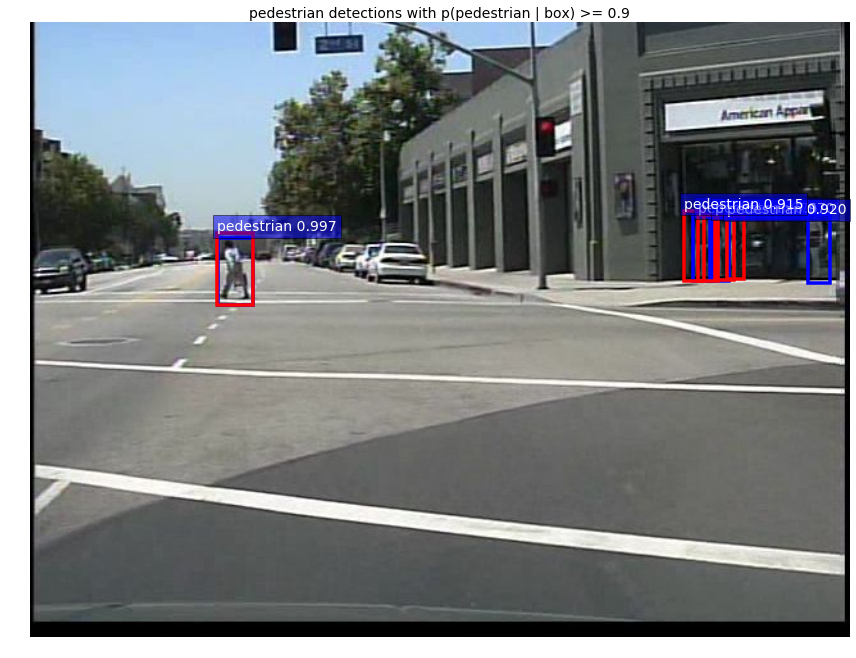

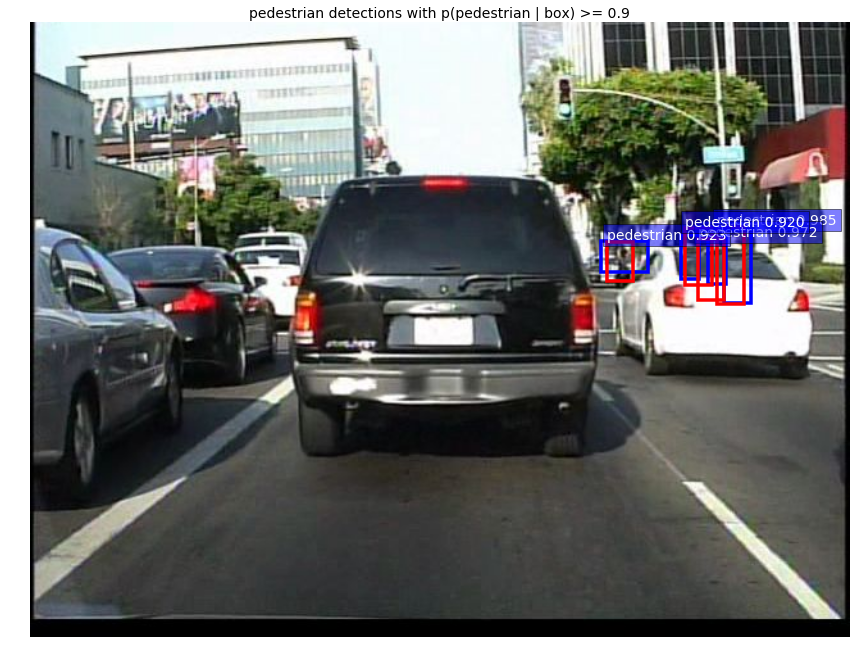

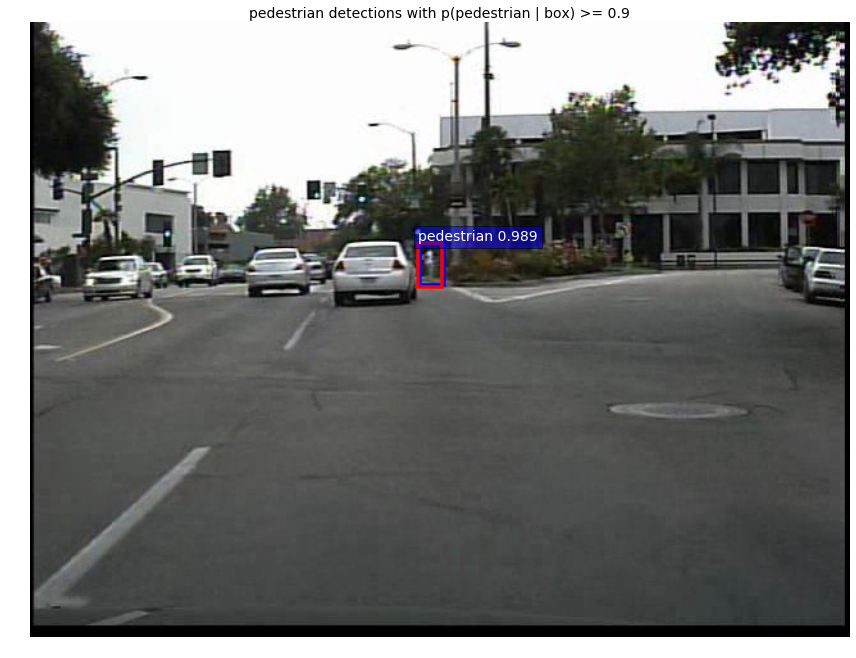

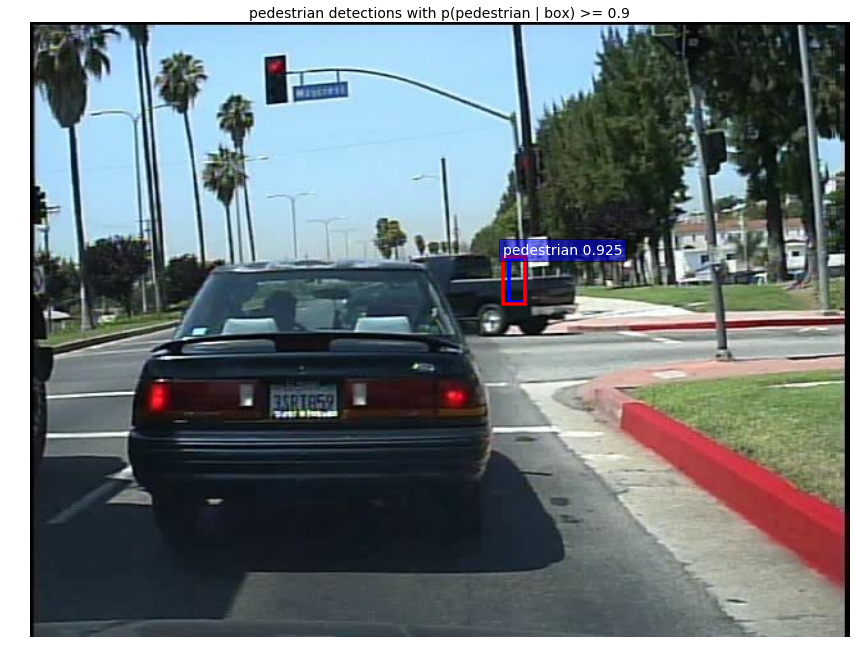

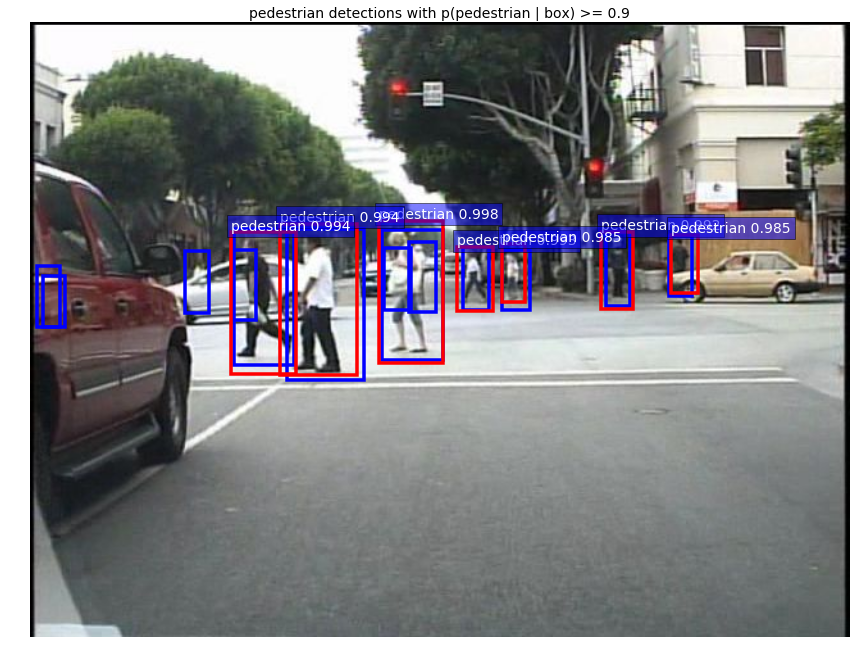

...

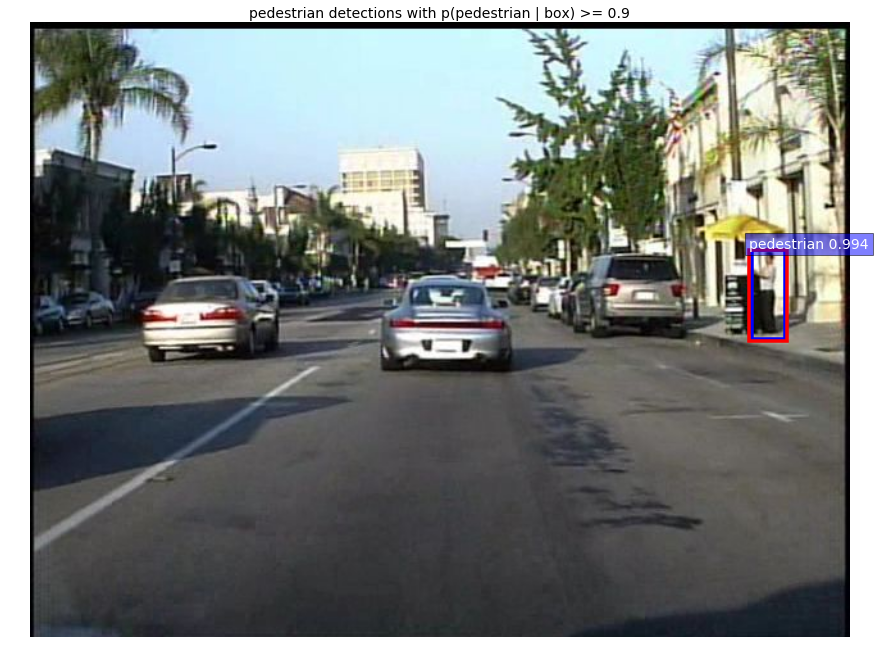

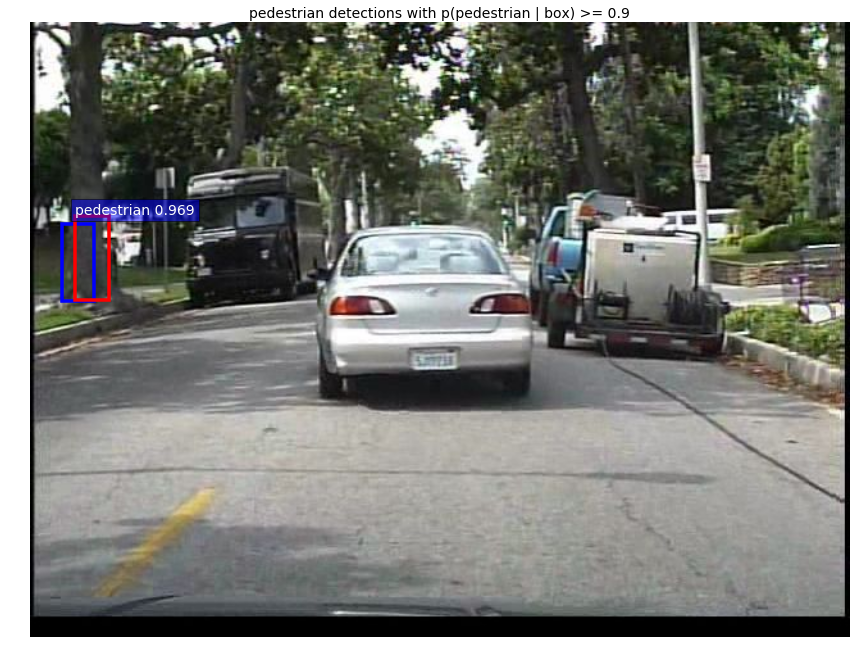

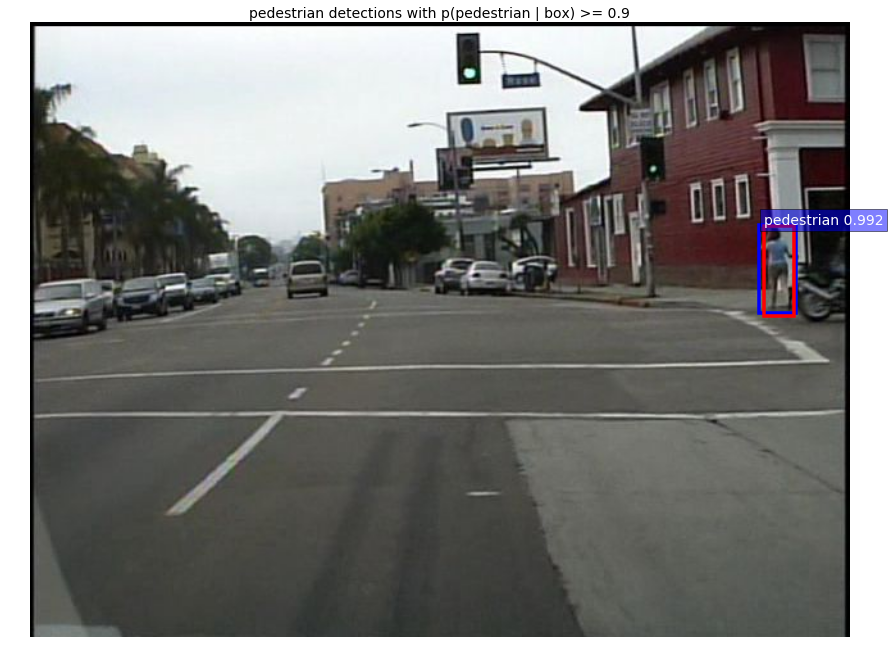

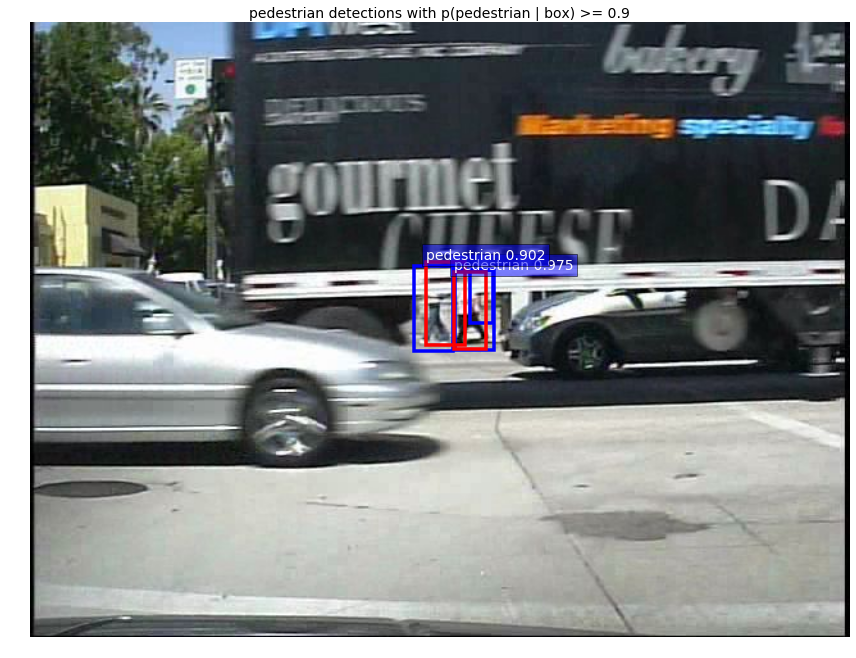

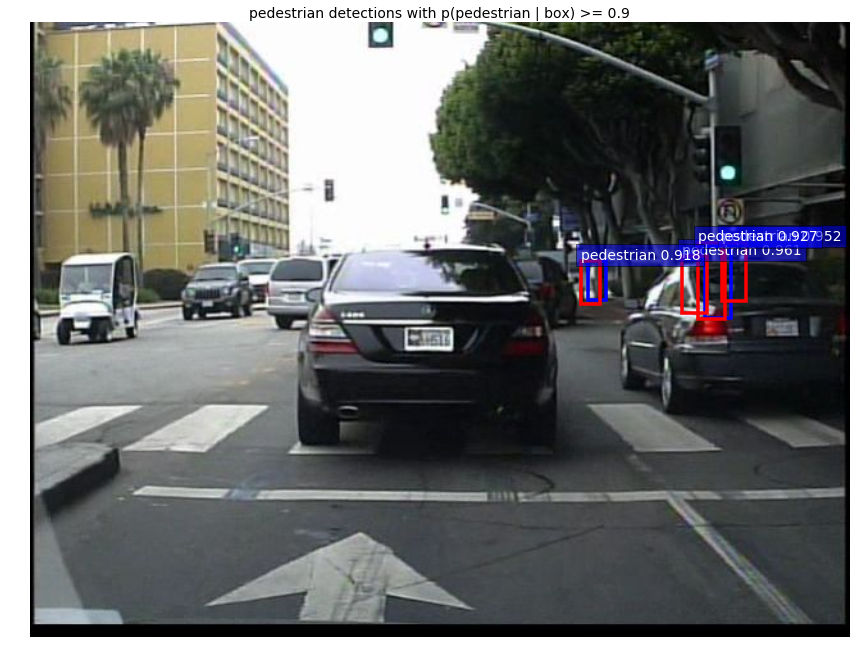

In [36]:
if __name__ == '__main__':
    sys.argv = ['./tools/demo.py', '--gpu', '2']

    
    cfg.TEST.HAS_RPN = True  # Use RPN for proposals

    args = parse_args()



    prototxt = '/root/py-faster-rcnn/models/caltech/VGG16/faster_rcnn_end2end/test.prototxt'
    caffemodel = "/root/py-faster-rcnn/output/faster_rcnn_end2end/caltech_pedestrian_trainval/vgg16_faster_rcnn_iter_60000.caffemodel"

    if not os.path.isfile(caffemodel):
        raise IOError(('{:s} not found.\nDid you run ./data/script/'
                       'fetch_faster_rcnn_models.sh?').format(caffemodel))

    if args.cpu_mode:
        caffe.set_mode_cpu()
    else:
        caffe.set_mode_gpu()
        caffe.set_device(args.gpu_id)
        cfg.GPU_ID = args.gpu_id
    net = caffe.Net(prototxt, caffemodel, caffe.TEST)

    print '\n\nLoaded network {:s}'.format(caffemodel)

    # Warmup on a dummy image
    im = 128 * np.ones((300, 500, 3), dtype=np.uint8)
    for i in xrange(2):
        _, _= im_detect(net, im)
    
    gt_annotation = json.load(open("/root/data/caltech-pedestrian-dataset-converter/data/annotations.json"))
        
    f = open("test_pedestrian.txt")
    im_names = [line.strip()  for line in f]
    
   
    for im_name in im_names:
        set_num, v_num, frame_num = im_name.split("_")
        frame_num = frame_num[:-4]
        gt_boxes = gt_annotation[set_num][v_num]["frames"].get(frame_num, None)
        set_num = int(set_num[-2:])
        if set_num < 6:
            continue
        print '~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~~'
        print 'Demo for data/demo/{}'.format(im_name)
        #demo(net, im_name)
        show_detection(net,im_name, gt_boxes)
        
    plt.show()
        
    


In [26]:
gt_boxes.keys()

[u'344',
 u'345',
 u'346',
 u'347',
 u'340',
 u'341',
 u'342',
 u'343',
 u'348',
 u'349',
 u'1653',
 u'298',
 u'299',
 u'296',
 u'297',
 u'294',
 u'295',
 u'292',
 u'293',
 u'290',
 u'291',
 u'270',
 u'271',
 u'272',
 u'273',
 u'274',
 u'275',
 u'276',
 u'277',
 u'278',
 u'279',
 u'1780',
 u'1781',
 u'108',
 u'109',
 u'102',
 u'103',
 u'100',
 u'101',
 u'106',
 u'107',
 u'104',
 u'105',
 u'1372',
 u'1001',
 u'1210',
 u'1375',
 u'1655',
 u'1374',
 u'99',
 u'98',
 u'91',
 u'90',
 u'93',
 u'92',
 u'95',
 u'94',
 u'97',
 u'96',
 u'1623',
 u'1622',
 u'1621',
 u'1620',
 u'1627',
 u'1626',
 u'1625',
 u'1624',
 u'1629',
 u'1377',
 u'559',
 u'558',
 u'555',
 u'554',
 u'557',
 u'556',
 u'551',
 u'550',
 u'553',
 u'552',
 u'1439',
 u'1199',
 u'1198',
 u'1191',
 u'1190',
 u'1193',
 u'1192',
 u'1195',
 u'1194',
 u'1197',
 u'1196',
 u'1759',
 u'1758',
 u'1757',
 u'1756',
 u'1755',
 u'1754',
 u'1753',
 u'1752',
 u'1751',
 u'1750',
 u'1177',
 u'1176',
 u'1175',
 u'1174',
 u'1173',
 u'1172',
 u'1171',


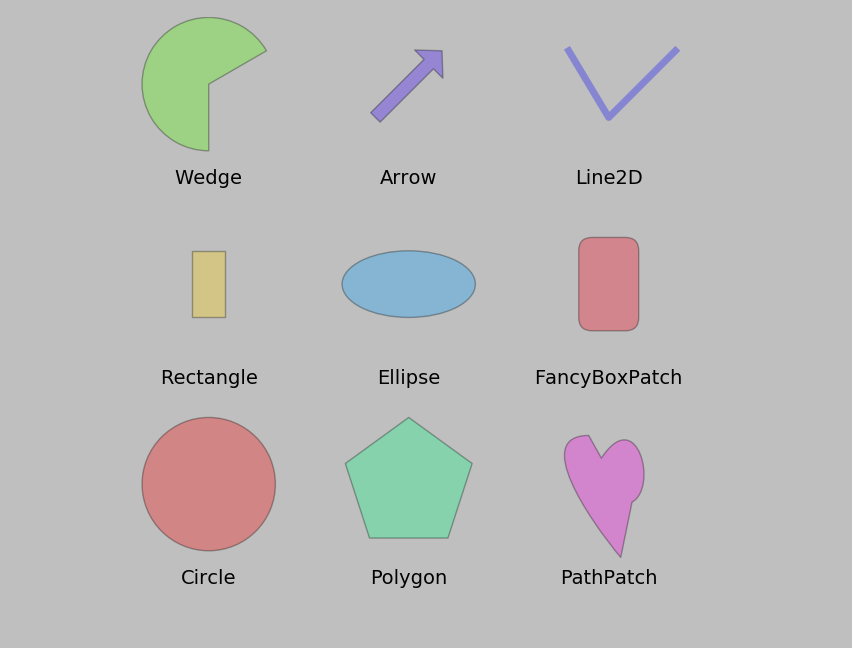

In [31]:
gt_boxes

[{u'end': 1139,
  u'hide': 0,
  u'id': 48,
  u'init': 1,
  u'lbl': u'person-fa',
  u'lock': 1,
  u'occl': 0,
  u'pos': [607.4337880079569,
   149.08837737993747,
   17.00483091787435,
   54.37411196362605],
  u'posv': [0, 0, 0, 0],
  u'str': 1075},
 {u'end': 1463,
  u'hide': 0,
  u'id': 45,
  u'init': 1,
  u'lbl': u'person-fa',
  u'lock': 0,
  u'occl': 0,
  u'pos': [530.667092924126,
   152.20929241261715,
   14.972577436771758,
   49.199566638249536],
  u'posv': [0, 0, 0, 0],
  u'str': 1008},
 {u'end': 1466,
  u'hide': 0,
  u'id': 47,
  u'init': 1,
  u'lbl': u'person-fa',
  u'lock': 0,
  u'occl': 0,
  u'pos': [517.175436913896,
   150.67442455242963,
   15.94606067064501,
   51.18831699346407],
  u'posv': [0, 0, 0, 0],
  u'str': 1011},
 {u'end': 1206,
  u'hide': 0,
  u'id': 18,
  u'init': 1,
  u'lbl': u'person',
  u'lock': 0,
  u'occl': 0,
  u'pos': [145.74069337880076,
   168.05711849957373,
   27.92168703230098,
   52.50959079283885],
  u'posv': [0, 0, 0, 0],
  u'str': 963}]